In [2]:
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [3]:
capacity1 = 10
profit_per_seat1 = 1000
compensation1 = 800
prob1 = 0.95

capacity2 = 30
profit_per_seat2 = 600
compensation2 = 300
prob2 = 0.9

capacity3 = 60
profit_per_seat3 = 200
compensation3 = 80
prob3 = 0.85

satisfaction = 1
dissatisfaction = 1
customer_retention1 = 0.8
customer_retention2 = 0.8
customer_retention3 = 0.8
step_size = 1e-7

In [4]:
def f(x1, x2, x3):
    profit = (profit_per_seat1 * min(capacity1, prob1*(capacity1 + (x1*capacity1)))) + \
            (profit_per_seat2 * min(capacity2, prob2*(capacity2 + (x2*capacity2)))) + \
            (profit_per_seat3 * min(capacity3, prob3*(capacity3 + (x3*capacity3)))) - \
            (compensation1 * max(0, (prob1*(capacity1 + (x1*capacity1))) - capacity1)) - \
            (compensation2 * max(0, (prob2*(capacity2 + (x2*capacity2))) - capacity2)) - \
            (compensation3 * max(0, (prob3*(capacity3 + (x3*capacity3))) - capacity3)) 
    retention_score = (customer_retention1 * min(capacity1, prob1*(capacity1 + (x1*capacity1)))) + \
            (customer_retention2 * min(capacity2, prob2*(capacity2 + (x2*capacity2)))) + \
            (customer_retention3 * min(capacity3, prob3*(capacity3 + (x3*capacity3))))
    
    return profit + retention_score

# def g(x1, x2, x3):
#     return ((min(capacity1, prob1*(capacity1 + (x1*capacity1)))) + \
#         min(capacity2, prob2*(capacity2 + (x2*capacity2))) + \
#         min(capacity3, prob3*(capacity3 + (x3*capacity3))) - \
#         max(0, (prob1*(capacity1 + (x1*capacity1))) - capacity1) - \
#         max(0, (prob2*(capacity2 + (x2*capacity2))) - capacity2) - \
#         max(0, (prob3*(capacity3 + (x3*capacity3))) - capacity3)) \
#                 #  / (capacity1*(1+x1) + capacity2*(1+x2) + capacity3*(1+x3))

def g(x1, x2, x3):
    return (satisfaction * min(capacity1, prob1*(capacity1 + (x1*capacity1)))) + \
            (satisfaction * min(capacity2, prob2*(capacity2 + (x2*capacity2)))) + \
            (satisfaction * min(capacity3, prob3*(capacity3 + (x3*capacity3)))) - \
            (dissatisfaction * max(0, (prob1*(capacity1 + (x1*capacity1))) - capacity1)) - \
            (dissatisfaction * max(0, (prob2*(capacity2 + (x2*capacity2))) - capacity2)) - \
            (dissatisfaction * max(0, (prob3*(capacity3 + (x3*capacity3))) - capacity3)) 

def grad_g(x1, x2, x3):
    
    tol = 0.5
    dx1 = g(x1 + tol, x2, x3) - g(x1 - tol, x2, x3) / (2*tol)
    dx2 = g(x1, x2 + tol, x3) - g(x1, x2 - tol, x3) / (2*tol)
    dx3 = g(x1, x2, x3 + tol) - g(x1, x2, x3 - tol) / (2*tol)

    return [dx1, dx2, dx3]

        
def grad_f(x1, x2, x3):

    dx1 = (profit_per_seat1 * int(prob1*(capacity1 + (x1*capacity1)) < capacity1)) - \
            (compensation1 * int(prob1*(capacity1 + (x1*capacity1)) - capacity1 > 0)) 

    dx2 = (profit_per_seat2 * int(prob2*(capacity2 + (x2*capacity2)) < capacity2)) - \
            (compensation2 * int(prob2*(capacity2 + (x2*capacity2)) - capacity2 > 0))

    dx3 = (profit_per_seat3 * int(prob3*(capacity3 + (x3*capacity3)) < capacity3)) - \
            (compensation3 * int(prob3*(capacity3 + (x3*capacity3)) - capacity3 > 0))
    
    dr1 = (customer_retention1 * int(prob1*(capacity1 + (x1*capacity1)) < capacity1))
    dr2 = (customer_retention2 * int(prob1*(capacity1 + (x1*capacity1)) < capacity1))
    dr3 = (customer_retention3 * int(prob1*(capacity1 + (x1*capacity1)) < capacity1))


    
    return [dx1+dr1, dx2+dr2, dx3+dr3]


Maximum first class overbooking (%) from graph : 5.3 %
Maximum business class overbooking (%) from graph : 11.1 %
Maximum economy class overbooking (%) from graph : 17.7 %
Maximum first class overbooking seats from graph (rounded off) :  1
Maximum business class overbooking seats from graph (rounded off) :  3
Maximum economy class overbooking seats from graph (rounded off) :  11


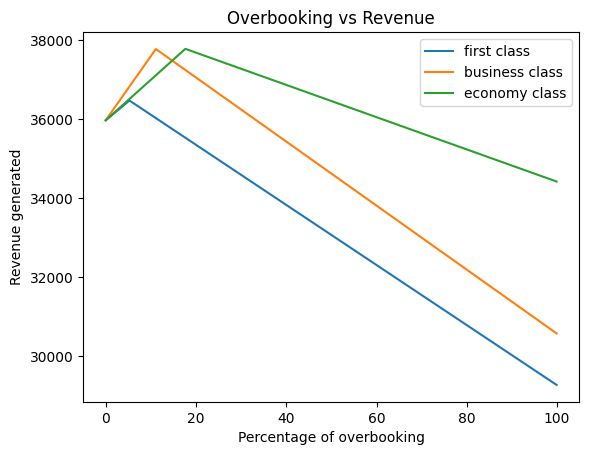

In [5]:
x = np.arange(0, 1, 0.001)
revenue1 = [f(cur_x, 0, 0) for cur_x in x]
revenue2 = [f(0, cur_x, 0) for cur_x in x]
revenue3 = [f(0, 0, cur_x) for cur_x in x]

plt.plot(x*100, revenue1, label="first class")
plt.plot(x*100, revenue2, label="business class")
plt.plot(x*100, revenue3, label="economy class")
plt.legend()
plt.xlabel("Percentage of overbooking")
plt.ylabel("Revenue generated")
plt.title("Overbooking vs Revenue")

print("Maximum first class overbooking (%) from graph :", x[np.argmax(revenue1)]*100, "%")
print("Maximum business class overbooking (%) from graph :", x[np.argmax(revenue2)]*100, "%")
print("Maximum economy class overbooking (%) from graph :", x[np.argmax(revenue3)]*100, "%")

print("Maximum first class overbooking seats from graph (rounded off) : ", round(x[np.argmax(revenue1)]*capacity1))
print("Maximum business class overbooking seats from graph (rounded off) : ", round(x[np.argmax(revenue2)]*capacity2))
print("Maximum economy class overbooking seats from graph (rounded off) : ", round(x[np.argmax(revenue3)]*capacity3))


Maximum first class overbooking (%) from graph : 5.3 %
Maximum business class overbooking (%) from graph : 11.1 %
Maximum economy class overbooking (%) from graph : 17.599999999999998 %
Maximum first class overbooking seats from graph (rounded off) :  1
Maximum business class overbooking seats from graph (rounded off) :  3
Maximum economy class overbooking seats from graph (rounded off) :  11


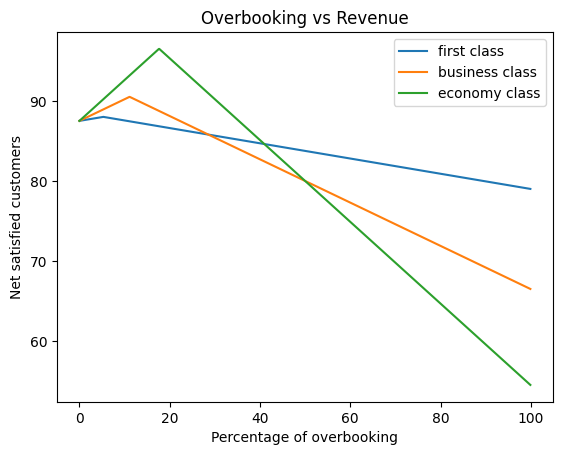

In [74]:
x = np.arange(0, 1, 0.001)
revenue1 = [g(cur_x, 0, 0) for cur_x in x]
revenue2 = [g(0, cur_x, 0) for cur_x in x]
revenue3 = [g(0, 0, cur_x) for cur_x in x]

plt.plot(x*100, revenue1, label="first class")
plt.plot(x*100, revenue2, label="business class")
plt.plot(x*100, revenue3, label="economy class")
plt.legend()
plt.xlabel("Percentage of overbooking")
plt.ylabel("Net satisfied customers")
plt.title("Overbooking vs Revenue")

print("Maximum first class overbooking (%) from graph :", x[np.argmax(revenue1)]*100, "%")
print("Maximum business class overbooking (%) from graph :", x[np.argmax(revenue2)]*100, "%")
print("Maximum economy class overbooking (%) from graph :", x[np.argmax(revenue3)]*100, "%")

print("Maximum first class overbooking seats from graph (rounded off) : ", round(x[np.argmax(revenue1)]*capacity1))
print("Maximum business class overbooking seats from graph (rounded off) : ", round(x[np.argmax(revenue2)]*capacity2))
print("Maximum economy class overbooking seats from graph (rounded off) : ", round(x[np.argmax(revenue3)]*capacity3))


In [75]:
x = np.arange(0, 1, 0.001)
revenue1 = [f(cur_x, 0, 0) for cur_x in x]
revenue2 = [f(0, cur_x, 0) for cur_x in x]
revenue3 = [f(0, 0, cur_x) for cur_x in x]

x1 = 0
all_x2 = []
all_x3 = []
total_revenue = []
all_x2 = np.arange(0, 1, 0.001)
all_x3 = np.arange(0, 1, 0.001)

for x2 in all_x2:
    revenue = []
    for x3 in all_x3:
        revenue.append(f(x1, x2, x3))
    total_revenue.append(revenue)

In [38]:
fig = go.Figure(data =
    go.Contour(
        x = all_x2,
        y = all_x3,
        z = total_revenue
    )
)
fig.update_layout(
    xaxis_title='Business class', 
    yaxis_title='Economy class'
)
fig.show()

Maximum first class overbooking (%) from optimization algorithm : 5.268 %
Maximum business class overbooking (%) from optimization algorithm : 11.114 %
Maximum economy class overbooking (%) from optimization algorithm : 17.649 %
Maximum first class overbooking seats from optimization algorithm (rounded off) :  1
Maximum business class overbooking seats from optimization algorithm (rounded off) :  3
Maximum economy class overbooking seats from optimization algorithm (rounded off) :  11


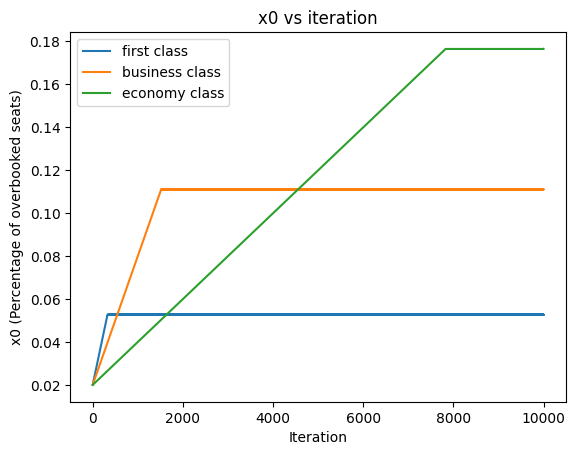

In [76]:
x1_0 = 0.02
x2_0 = 0.02
x3_0 = 0.02

all_x = []
all_iter = []
for i in range(10000):
    gradient = grad_f(x1_0, x2_0, x3_0)
    x1_new = x1_0 + (step_size * gradient[0])
    x2_new = x2_0 + (step_size * gradient[1])
    x3_new = x3_0 + (step_size * gradient[2])


    if abs(x1_new - x1_0) <= 1e-5 and abs(x2_new - x2_0) <= 1e-5 and abs(x3_new - x3_0) <= 1e-5:
        break
    x1_0 = x1_new
    x2_0 = x2_new
    x3_0 = x3_new

    all_x.append([x1_0, x2_0, x3_0])
    all_iter.append(i)

plt.plot(all_iter, all_x, label=["first class", "business class", "economy class"])
plt.legend()
plt.xlabel("Iteration")
plt.ylabel("x0 (Percentage of overbooked seats)")
plt.title("x0 vs iteration")


print("Maximum first class overbooking (%) from optimization algorithm :", round(x1_0*100, 3), "%")
print("Maximum business class overbooking (%) from optimization algorithm :", round(x2_0*100, 3), "%")
print("Maximum economy class overbooking (%) from optimization algorithm :", round(x3_0*100, 3), "%")

print("Maximum first class overbooking seats from optimization algorithm (rounded off) : ", round(x1_0*capacity1))
print("Maximum business class overbooking seats from optimization algorithm (rounded off) : ", round(x2_0*capacity2))
print("Maximum economy class overbooking seats from optimization algorithm (rounded off) : ", round(x3_0*capacity3))

Maximum first class overbooking (%) from optimization algorithm : 5.269 %
Maximum business class overbooking (%) from optimization algorithm : 11.115 %
Maximum economy class overbooking (%) from optimization algorithm : 17.648 %
Maximum first class overbooking seats from optimization algorithm (rounded off) :  1
Maximum business class overbooking seats from optimization algorithm (rounded off) :  3
Maximum economy class overbooking seats from optimization algorithm (rounded off) :  11


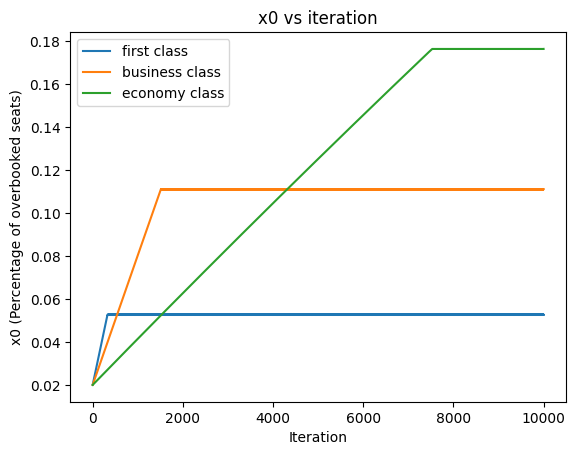

In [77]:
x1_0 = 0.02
x2_0 = 0.02
x3_0 = 0.02
step_size = np.array([[1e-7, 1e-7]])

all_x = []
all_iter = []
for i in range(10000):
    gradient_f = grad_f(x1_0, x2_0, x3_0)
    gradient_g = grad_g(x1_0, x2_0, x3_0)

    gradient = np.array([gradient_f, gradient_g])
    delta = np.matmul(step_size, gradient)[0]
    x1_new = x1_0 + delta[0]
    x2_new = x2_0 + delta[1]
    x3_new = x3_0 + delta[2]


    if abs(x1_new - x1_0) <= 1e-5 and abs(x2_new - x2_0) <= 1e-5 and abs(x3_new - x3_0) <= 1e-5:
        break
    x1_0 = x1_new
    x2_0 = x2_new
    x3_0 = x3_new

    all_x.append([x1_0, x2_0, x3_0])
    all_iter.append(i)

plt.plot(all_iter, all_x, label=["first class", "business class", "economy class"])
plt.legend()
plt.xlabel("Iteration")
plt.ylabel("x0 (Percentage of overbooked seats)")
plt.title("x0 vs iteration")


print("Maximum first class overbooking (%) from optimization algorithm :", round(x1_0*100, 3), "%")
print("Maximum business class overbooking (%) from optimization algorithm :", round(x2_0*100, 3), "%")
print("Maximum economy class overbooking (%) from optimization algorithm :", round(x3_0*100, 3), "%")

print("Maximum first class overbooking seats from optimization algorithm (rounded off) : ", round(x1_0*capacity1))
print("Maximum business class overbooking seats from optimization algorithm (rounded off) : ", round(x2_0*capacity2))
print("Maximum economy class overbooking seats from optimization algorithm (rounded off) : ", round(x3_0*capacity3))